# 01 ETL Pipelines

![data_flow](https://cdn.dribbble.com/users/1752792/screenshots/5652276/media/12db9ebc672c30dcb4d0fd125f70fb41.png)

Source: [Mindaugas Sadūnas](https://dribbble.com/shots/5652276-User-flow/attachments/10982649?mode=media)

## Table of Contents

1. [Overview](#1.-Overview)
2. [Learning Outcomes](#2.-Learning-Outcomes)
3. [Data](#3.-Data)
4. [Tools](#4.-Tools)
5. [Data Pipelines](#5.-Data-Pipelines)
6. [🐼 `pipe`lines](#6.-🐼-`pipe`lines)
7. [Extract](#7.-Extract)
8. [Transform](#8.-Transform)
9. [Load](#9.-Load)
10. [Launch a Pipeline](#10.-Launch-a-Pipeline)
11. [Summary](#11.-Summary)

## 1. Overview

You are a data analyst working at Beautiful Analytics, and you have been given a project in which you will work using data generated from shared bikes systems in the cities of London (England, UK), Seoul (South Korea), and Washington (DC, USA). Your customer's are the governments of each city and what they want to solve is the same, 

** [A bicycle-sharing system](https://en.wikipedia.org/wiki/Bicycle-sharing_system) is a shared transport service where bicycles are available for shared use by individuals for a short-term at low or zero cost.

**Challenge #1**

> To predict/forecast how many bikes they will to need to have available in the city at every hour of the day for the next few years to make sure customers are happy and revenue is maximized

Each government captures similar data but, as you can imagine, they all use different words and measure similar variables in different ways. This means that our first job before we can answer the question above is to fix the data and put it in a user-friendly format. While we are at it, we should also try and automate our pipeline so that the next time we need to read, transform, and load new versions of all the data sources for this project, we could do so with the click of a button rather than having to write everything again from scratch. So our first real problem is,

**Challenge #0**

> Create a data pipeline that extracts, transforms and loads the necessary data for the task at hand.

## 2. Learning Outcomes

Before we get started, let's go over the learning outcomes for this section of the workshop.

By the end of this lesson you will be able to,
1. Discuss what ETL and ELT Pipelines are.
2. Understand how to read and combine data that comes from different sources.
3. Create data pipelines using Pandas and Prefect.
4. Understand how to visualize the pipelines you create to help you with their development.

## 3. Data

![bikes](https://images.pexels.com/photos/11803508/pexels-photo-11803508.jpeg?cs=srgb&dl=pexels-%D1%80%D0%BE%D0%BC%D0%B0%D0%BD-%D0%BA%D0%B0%D0%B4%D1%8C%D0%BA%D0%B0%D0%BB%D0%BE%D0%B2-11803508.jpg&fm=jpg)

All three data files contain similar information about how many bicycles have been rented each hour, day, week and months for several years and for each city government we are working with.

You can get more information about the data of each city using the following links.

- [Seoul, Korea del Sur](https://archive.ics.uci.edu/ml/datasets/Seoul+Bike+Sharing+Demand#)
- [London, England, UK](https://www.kaggle.com/hmavrodiev/london-bike-sharing-dataset)
- [Washington, DC, USA](https://www.kaggle.com/marklvl/bike-sharing-dataset?select=hour.csv)

Here are the variables that appear in the three data files.

|     London      |      Seoul      |    Washington   |
|:---------------:|:---------------:|:---------------:|
| date            | date            | instant         |
| count           | count           | date            |
| temperature     | hour            | seasons         |
| t2              | temperature     | year            |
| humidity        | humidity        | month           |
| wind_speed      | wind_speed      | hour            |
| weather_code    | visibility      | is_holiday      |
| is_holiday      | dew_point_temp  | weekday         |
| is_weekend      | solar_radiation | workingday      |
| seasons         | rainfall        | weathersit      |
|                 | snowfall        | temperature     |
|                 | seasons         | count           |
|                 | is_holiday      | humidity        |
|                 | functioning_day | wind_speed      |
|                 |                 | casual          |
|                 |                 | registered      |

Since all of these datasets where generated with different business logic and, most likely, by completely different systems, we can certainly expect more inconsistencies than just unmatching column names, numerical formats, and data collected. We will walk through a few cleaning steps after we discuss the tools we will be using today.

## 4. Tools

The tools that we will use in the workshop are the following.

- [pandas](https://pandas.pydata.org/) - "is a fast, powerful, flexible and easy to use open source data analysis and manipulation tool, built on top of the Python programming language."
- [Prefect](https://docs.prefect.io/) - "is a new workflow management system, designed for a modern infrastructure and powered by the open source workflow engine, Prefect Core. Users organize tasks into `task`'s and` flow`'s, and Prefect takes care of the rest."
- [sqlite3](https://docs.python.org/3/library/sqlite3.html) - "SQLite is a library written in C that provides a lightweight disk-based database that does not require a separate server process and allows the database to be accessed using a non-standard variant of the SQL query language."
- [pathlib](https://docs.python.org/3/library/pathlib.html) - allows us to manipulate paths as if they were python objects.

Before we continue, let's load the modules we'll need and examine our datasets.

In [3]:
import pandas as pd
from prefect import flow, task
import sqlite3
from contextlib import closing
from pathlib import Path

# Some default settings in Pandas
pd.options.display.max_rows = None
pd.options.display.max_columns = None

In [4]:
path = Path().cwd().parent.joinpath("data", "01_part") #for multi OS support
path

PosixPath('/Users/mark.stent/Dropbox/Data_Science/Python/Pycon/pycon-za2022-analytics-devops/data/01_part')

We will need paths to all of our datasets.

In [5]:
london_path = path.joinpath('raw', 'london', 'london_bikes.db')
seoul_path = path.joinpath('raw', 'seoul', 'SeoulBikeData.csv')
wash_dc_path = path.joinpath('raw', 'wash_dc', 'washington.json')
london_path 

PosixPath('/Users/mark.stent/Dropbox/Data_Science/Python/Pycon/pycon-za2022-analytics-devops/data/01_part/raw/london/london_bikes.db')

The data we have about the bikes in London is in a SQLite database and to read it, we first need to create a connection to its database using the `sqlite3` package.

The next step is to use the pandas `read_sql_query` function from Pandas to read the data. This function takes two arguments, the connection to our databaset and the query to get the data we want.

Note that we can make quite elaborate queries to get a subset of the data we'll be working with, but for our purposes this is not necessary.

In [6]:
conn = sqlite3.connect(london_path)
query = "SELECT * FROM uk_bikes"

In [7]:
london = pd.read_sql_query(query, conn)
london.head()

,timestamp,cnt,t1,t2,hum,wind_speed,weather_code,is_holiday,is_weekend,seasonreal
0,2015-01-04 00:00:00,182,3.0,2.0,93.0,6.0,3.0,0.0,1.0,3.0
1,2015-01-04 01:00:00,138,3.0,2.5,93.0,5.0,1.0,0.0,1.0,3.0
2,2015-01-04 02:00:00,134,2.5,2.5,96.5,0.0,1.0,0.0,1.0,3.0
3,2015-01-04 03:00:00,72,2.0,2.0,100.0,0.0,1.0,0.0,1.0,3.0
4,2015-01-04 04:00:00,47,2.0,0.0,93.0,6.5,1.0,0.0,1.0,3.0


Seoul data is in text form and separated by commas, and the data for DC is in JSON format. For these two we can use `pd.read_csv` and` pd.read_json`, respectively.

In [8]:
seoul = pd.read_csv(seoul_path)
seoul.head()

,Date,Rented Bike Count,Hour,Temperature(�C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(�C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Seasons,Holiday,Functioning Day
0,01/12/2017,254,0,-5.2,37,2.2,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
1,01/12/2017,204,1,-5.5,38,0.8,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
2,01/12/2017,173,2,-6.0,39,1.0,2000,-17.7,0.0,0.0,0.0,Winter,No Holiday,Yes
3,01/12/2017,107,3,-6.2,40,0.9,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
4,01/12/2017,78,4,-6.0,36,2.3,2000,-18.6,0.0,0.0,0.0,Winter,No Holiday,Yes


In [9]:
washington = pd.read_json(wash_dc_path)
washington.head()

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1


## 5. Data Pipelines

![etl_pipe](https://databricks.com/wp-content/uploads/2021/05/ETL-Process.jpg)

**What are ETL Pipelines?**

The acronym ETL stands for Extract, Transform, and Load, and it is the process by which organizations' data passes through before it reaches the hands of data consumers. Which can be analysts, marketers, sales people, customers, and so on...

**Why should you learn how to create them?**

ETL tools enable data integration strategies by allowing companies to gather data from multiple data sources and consolidate it into a single, centralized location. ETL tools also make it possible for different types of data to work together.

As data professionals, our task is to create value for our organizations, our clients and our collaborators using some of, if not all, the data that we have at our disposal. However, to get the most out of our organization's data, we often need
1. Information about the process by which it was generated, For example,
    - Point of sale
    - Clicks on an online marketplace like Amazon, Etzy, Ebay, ect.
    - A/B Test Results
    - ...
2. Information about the transformations that occurred during the cleaning and merging process. For instance,
    - Celcius degrees were converted into fahrenheit
    - Prices in Chilean pesos were converted to Rands
    - Non-numerical and unavailable observations now contain "Not Available" or "Unknown"
    - ...
3. Information about how the data was stored and where. For instance,
    - Parquet format
    - NOSQL or SQL database
    - CSV
    - ...


Understanding how the three processes described above flow will help us have more knowledge about the data that we are going to use, and how to best access it, transform it, and model it before we put it to good use.

**A Quick sideline**

Let's walk through an example of a data pipeline using data from wildfires between 1983-2020 in the United States and using Prefect to visualise it. You can find more information about the dataset [here](https://www.kaggle.com/kkhandekar/total-wildfires-acres-affected-1983-2020).

In [10]:
example_data_in = path.joinpath("example", "federal_firefighting_costs.csv")
pd.read_csv(example_data_in).head()

,Year,Fires,Acres,ForestService,DOIAgencies,Total
0,1985,"82,591","2,896,147","$161,505,000","$78,438,000","$239,943,000"
1,1986,"85,907","2,719,162","$111,625,000","$91,153,000","$202,778,000"
2,1987,"71,300","2,447,296","$253,657,000","$81,452,000","$335,109,000"
3,1988,"72,750","5,009,290","$429,609,000","$149,317,000","$578,926,000"
4,1989,"48,949","1,827,310","$331,672,000","$168,115,000","$499,787,000"


As you can see, most columns contain a `$` dollar sign and some `,` commas, and because this forces Python to treat numbers as objects rather than `int`'s or `float`'s, we will have to remove these signs in our transformation step after extracting the data and before loading a clean version of it.

- About Prefect - Prefect is a Python-based workflow management system based on a simple premise — Your code probably works, but sometimes it doesn't (source). No one thinks about workflow systems when everything works as expected. But when things go south, Prefect will guarantee your code fails successfully. It creates Directed Acyclic Graphs (DAG's) where nodes are functions of computations linking one step to another.

When you use Prefect you have two important APIs, one is the `task` API and the other is` flow`. The former is used as a decorator on top of functions and this allows us to signal to Prefect that our decorated functions can become a node in a graph. The latter represents a set the graph we want to run and it is composed of one or multiple tasks, or even multiple flows.

For example, let's create 3 functions, one that extracts the data we need, another that takes anything that is non-numerical out of our variables, and another that loads the cleaned data somewhere. Each function will have the `task` decorator on top of it.

In [11]:
@task(name="Get Data!")
def extract(path):
    return pd.read_csv(path)

As you saw above, only the last 5 variables have commas (`,`) and dollar symbols (`$`) so we will replace both with an empty space (` "" `) using a `for` loop.



In [12]:
#takes a CSV dataset and returns a cleaned dataset

@task(name="Transform Data!")
def transform(data):
    for col in data.iloc[:, 1:].columns:
        data[col] = data[col].str.replace(r'[^0-9]+', '', regex=True).astype(int)
    return data

For the download process, we will save the data in the `parquet` format. This is one of the most popular formats to save data in due to its compression capabilities, orientation, and speed gains in analytical workloads.

Here's an example on the differences between the row-like format and the columnar format of parquet files. If this interests you you can read more about it [here](https://datos.gob.es/en/blog/why-should-you-use-parquet-files-if-you-process-lot-data)

![colvsrow](https://3.bp.blogspot.com/-3aUydn8zCsQ/VjslzWCu3pI/AAAAAAAAAI8/XOi77xQNmm0/s1600/Difference-between-Column-based-and-Row-based-Tables.png)

Source: [SAP HANA Central](http://www.hanaexam.com/p/row-store-vs-column-store.html)

In [13]:
@task(name="Load Data!")
def load(data, path):
    data.to_parquet(path, compression='snappy')

Now we create an output file path to save our data to

In [14]:
#Create a Posix path for our output file

example_data_out = path.joinpath("example", "my_test.parquet") 


When we have all the steps ready, we create a new function containing our graph using the `flow` decorator. We can give this function a name, for example, `"Example Pipeline! 😎"` and then chain the tasks we created previously in the order in which they should be run.


In [15]:
@flow(name="Example Pipeline! 😎")
def example_etl(example_data_in, example_data_out):
    data = extract(example_data_in)
    data_clean = transform(data)
    load(data_clean, example_data_out)
    print("Your Pipeline Ran Successfully!")
    


Now that our function is created, we can simply run it with the arguments necessary and Prefect will do its magic.

In [16]:
example_etl(example_data_in, example_data_out)

18:15:51.253 | INFO    | prefect.engine - Created flow run 'fresh-shellfish' for flow 'Example Pipeline! 😎'
18:15:51.331 | INFO    | Flow run 'fresh-shellfish' - Created task run 'Get Data!-bb1266fe-0' for task 'Get Data!'
18:15:51.332 | INFO    | Flow run 'fresh-shellfish' - Executing 'Get Data!-bb1266fe-0' immediately...
18:15:51.360 | INFO    | Task run 'Get Data!-bb1266fe-0' - Finished in state Completed()
18:15:51.370 | INFO    | Flow run 'fresh-shellfish' - Created task run 'Transform Data!-a7d916b4-0' for task 'Transform Data!'
18:15:51.370 | INFO    | Flow run 'fresh-shellfish' - Executing 'Transform Data!-a7d916b4-0' immediately...
18:15:51.396 | INFO    | Task run 'Transform Data!-a7d916b4-0' - Finished in state Completed()
18:15:51.408 | INFO    | Flow run 'fresh-shellfish' - Created task run 'Load Data!-60b30268-0' for task 'Load Data!'
18:15:51.408 | INFO    | Flow run 'fresh-shellfish' - Executing 'Load Data!-60b30268-0' immediately...
18:15:51.458 | INFO    | Task run 'L

Your Pipeline Ran Successfully!


[Completed(message=None, type=COMPLETED, result=    Year   Fires       Acres   ForestService   DOIAgencies           Total
 0   1985  82,591   2,896,147    $161,505,000   $78,438,000    $239,943,000
 1   1986  85,907   2,719,162    $111,625,000   $91,153,000    $202,778,000
 2   1987  71,300   2,447,296    $253,657,000   $81,452,000    $335,109,000
 3   1988  72,750   5,009,290    $429,609,000  $149,317,000    $578,926,000
 4   1989  48,949   1,827,310    $331,672,000  $168,115,000    $499,787,000
 5   1990  66,481   4,621,621    $253,700,000  $144,252,000    $397,952,000
 6   1991  75,754   2,953,578    $132,300,000   $73,820,000    $206,120,000
 7   1992  87,394   2,069,929    $290,300,000   $87,166,000    $377,466,000
 8   1993  58,810   1,797,574    $184,000,000   $56,436,000    $240,436,000
 9   1994  79,107   4,073,579    $757,200,000  $161,135,000    $918,335,000
 10  1995  82,234   1,840,546    $367,000,000  $110,126,000    $477,126,000
 11  1996  96,363   6,065,998    $547,500

To see the graph we just ran, we can open the terminal and run `prefect orion start`. This will take us to the Prefect UI where we can evaluate not only the run and graph, but also the parameters and logs collected from all DAGs we run.

To make sure we have the correct data, let's create a visualization with pandas.

<AxesSubplot: title={'center': 'Forest Service costs by year'}, xlabel='Year'>

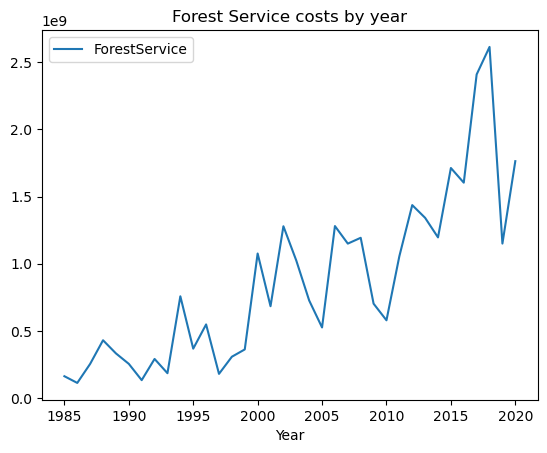

In [17]:
pd.read_parquet(path.joinpath("example", "my_test.parquet")).plot(x='Year', y="ForestService", kind='line', title="Forest Service costs by year")


## 6. 🐼 `pipe`lines

![](https://camo.githubusercontent.com/45ae53e215244585378c3e414ce05abb4f5f6be3/68747470733a2f2f6d656469612e67697068792e636f6d2f6d656469612f4978365150753533576c4236772f67697068792e676966)

The `pipe` operator is a Pandas function that allows you to chain operations that take a data set, modify it, and return the modified version of the original data. In essence, it allows us to move the data through a series of steps until we reach the structure in which we want it to end up.

For example, imagine that we have a dataset called 'data' and 4 functions to fix it, the chain of operations would look like this.

```python 
(data.pipe(change_cols, list_of_cols) #change column names
     .pipe(clean_numeric_vars, list_of_numeric_vars) #remove non numeric characters
     .pipe(add_dates_and_location, 'Auckland', 'NZ') #separate dates into month, day and year and replace City and Country
     .pipe(fix_and_drop, 'column_to_fix', seasons_NZ, cols_drop_NZ)) #fix column data and drop collumns not needed
```

Another way to visualize what happens with pandas' `pipe` is through the following food process where we have ingredients and we actually require food.

![img](../images/pandas_pipe.png)

Let's start with a small example without `pipe` first.

In [18]:
#create some toy data for our Bicycle problem

toy_data = pd.DataFrame({"Postal Codes": [22345, 32442, 20007], 
                         "Cities":       ["Miami", "Dallas", "Washington"],
                         "Date":         pd.date_range(start='9/27/2021', periods=3)})
toy_data

,Postal Codes,Cities,Date
0,22345,Miami,2021-09-27
1,32442,Dallas,2021-09-28
2,20007,Washington,2021-09-29


In [19]:
#create a function to rename the columns correctly

def change_cols(data, cols_list):
    data.columns = cols_list
    return data

In [20]:
#run the function with new column names

change_cols(toy_data, ["postal_code", "city", "date"])

,postal_code,city,date
0,22345,Miami,2021-09-27
1,32442,Dallas,2021-09-28
2,20007,Washington,2021-09-29


As you can see, with a single function it doesn't make much sense to pipe the process but with a chain of functions, the story changes.

The next thing we want to do is add additional information about the dates we have for each file. We can achieve this after converting the `date` variable to `datetime` format, which will allow us to access the year, month, week, ect. inside each date.

In [21]:
#Convert date field to a datetime format, separate date into month, day, year, day of the week and whethere it is weekend or not. If there is already an hour column then dont overwrite it, else create an hour column too. Create city and country columns

def add_dates_and_location(data, city, country):
    
    data['date']       = pd.to_datetime(data['date'], infer_datetime_format=True, dayfirst=True)
    data["year"]       = data['date'].dt.year
    data["month"]      = data['date'].dt.month
    data["week"]       = data['date'].dt.isocalendar().week.astype(int)
    data["day"]        = data['date'].dt.day
    data["weekday"]    = data['date'].dt.dayofweek
    data["is_weekend"] = (data["weekday"] > 4).astype(int)
    
    # note that we don't want to overwrite data that already has the hour as a column
    if 'hour' not in data.columns: 
        data["hour"]   = data['date'].dt.hour
    data['date']       = data['date'].dt.date
    
    # non-date variables
    data['city']       = city
    data['country']    = country
    
    return data

In [22]:
#run the function with the toy data

add_dates_and_location(toy_data, "Sydney", "AU")

,postal_code,city,date,year,month,week,day,weekday,is_weekend,hour,country
0,22345,Sydney,2021-09-27,2021,9,39,27,0,0,0,AU
1,32442,Sydney,2021-09-28,2021,9,39,28,1,0,0,AU
2,20007,Sydney,2021-09-29,2021,9,39,29,2,0,0,AU


As you can see, we added a lot of information to our data with a simple function, but what happens when we want to chain two or three or four operations together? The following would not be very easy to read right? 
```python
add_dates_and_location(change_cols (toy_data, [" postal_code "," city "," date "])," Sydney "," AU ")
```

Let's move on to using our `pipe` operator now.

In [23]:
#receate the toy dataset

toy_data = pd.DataFrame({"Postal Codes": [22345, 32442, 20007], 
                         "Cities":       ["Miami", "Dallas", "Washington"],
                         "Date":         pd.date_range(start='9/27/2021', periods=3)})
toy_data

,Postal Codes,Cities,Date
0,22345,Miami,2021-09-27
1,32442,Dallas,2021-09-28
2,20007,Washington,2021-09-29


In [24]:
(
    toy_data.pipe(change_cols, ["zip_code", "city", "date"])
            .pipe(add_dates_and_location, "Sydney", "AU")
)

,zip_code,city,date,year,month,week,day,weekday,is_weekend,hour,country
0,22345,Sydney,2021-09-27,2021,9,39,27,0,0,0,AU
1,32442,Sydney,2021-09-28,2021,9,39,28,1,0,0,AU
2,20007,Sydney,2021-09-29,2021,9,39,29,2,0,0,AU


As you can see, now our chained functions are more readable than before and we can continue and chain even more functions in the same fashion.

Moving on...

In our data we have the stages of the year with different names and we also have variables that we do not need or that are not in the three files. Let's fix both!

In [25]:
#create lists of all the column names for each city

london_cols = ['date', 'count', 'temperature', 'temp_feels_like', 'humidity', 'wind_speed', 'weather_code', 'is_holiday', 'is_weekend', 'seasons']
seoul_cols = ['date', 'count', 'hour', 'temperature', 'humidity', 'wind_speed', 'visibility', 'dew_point_temp', 'solar_radiation', 'rainfall', 'snowfall', 'seasons', 'is_holiday', 'functioning_day']
wa_dc_cols = ['instant', 'date', 'seasons', 'year', 'month', 'hour', 'is_holiday', 'weekday', 'workingday', 'weathersit', 'temperature', 'temp_feels_like', 'humidity', 'wind_speed', 'casual', 'registered', 'count']

In [26]:
#create mappings for each country season data (they are all mapped very differently!)

seasons_london = {0: 'Spring', 1: 'Summer', 2: 'Fall', 3: 'Winter'}
seasons_wa_dc = {1: 'Spring', 2: 'Summer', 3: 'Fall', 4: 'Winter'}
holidays_seoul = {'No Holiday': 0, 'Holiday': 1}

In [27]:
#create lists of columns we dont need

cols_drop_london = ['temp_feels_like', 'weather_code']
cols_drop_seoul = ['visibility', 'dew_point_temp', 'solar_radiation', 'rainfall', 'snowfall', 'functioning_day']
cols_drop_wa_dc = ['instant', 'temp_feels_like', 'casual', 'registered', 'workingday', 'weathersit']

In [28]:
#Create a function to update the columns and apply the mappings and then drops the non required columns them.

def fix_and_drop(data, col_to_fix, mapping, cols_to_drop):
    data[col_to_fix] = data[col_to_fix].map(mapping)
    return data.drop(cols_to_drop, axis=1)

Let's test the `pipe` operator but with the data from DC now and evaluate the results.

In [29]:
(washington.pipe(change_cols, wa_dc_cols)
           .pipe(fix_and_drop, 'seasons', seasons_wa_dc, cols_drop_wa_dc)).head()

,date,seasons,year,month,hour,is_holiday,weekday,temperature,humidity,wind_speed,count
0,2011-01-01,Spring,0,1,0,0,6,0.24,0.81,0.0,16
1,2011-01-01,Spring,0,1,1,0,6,0.22,0.80,0.0,40
2,2011-01-01,Spring,0,1,2,0,6,0.22,0.80,0.0,32
3,2011-01-01,Spring,0,1,3,0,6,0.24,0.75,0.0,13
4,2011-01-01,Spring,0,1,4,0,6,0.24,0.75,0.0,1


Finally, we can use our `pipe` operator again to complete the process and see the end result.

Since we haven't created a function to read JSON files, let's create one and call it `extract_data`.

In [30]:
#Create an extract data function from JSON file

def extract_data(path):
    return pd.read_json(path)

In [31]:
washington = (extract_data(wash_dc_path).pipe(change_cols, wa_dc_cols)
                                        .pipe(add_dates_and_location, 'DC', 'USA')
                                        .pipe(fix_and_drop, 'seasons', seasons_wa_dc, cols_drop_wa_dc))
washington.head()

,date,seasons,year,month,hour,is_holiday,weekday,temperature,humidity,wind_speed,count,week,day,is_weekend,city,country
0,2011-01-01,Spring,2011,1,0,0,5,0.24,0.81,0.0,16,52,1,1,DC,USA
1,2011-01-01,Spring,2011,1,1,0,5,0.22,0.80,0.0,40,52,1,1,DC,USA
2,2011-01-01,Spring,2011,1,2,0,5,0.22,0.80,0.0,32,52,1,1,DC,USA
3,2011-01-01,Spring,2011,1,3,0,5,0.24,0.75,0.0,13,52,1,1,DC,USA
4,2011-01-01,Spring,2011,1,4,0,5,0.24,0.75,0.0,1,52,1,1,DC,USA


## Exercise

1. Create a function to extract the London data.
2. Create a data pipe similar to the one in Washington using pandas' `pipe`.

In [32]:
#1
query = "SELECT * FROM uk_bikes"

def londonExtract(path, query):
    conn = sqlite3.connect(london_path)
    return pd.read_sql_query(query, conn)

In [50]:
#2
londonExtract(london_path, query).pipe(change_cols, london_cols ).head()

,date,count,temperature,temp_feels_like,humidity,wind_speed,weather_code,is_holiday,is_weekend,seasons
0,2015-01-04 00:00:00,182,3.0,2.0,93.0,6.0,3.0,0.0,1.0,3.0
1,2015-01-04 01:00:00,138,3.0,2.5,93.0,5.0,1.0,0.0,1.0,3.0
2,2015-01-04 02:00:00,134,2.5,2.5,96.5,0.0,1.0,0.0,1.0,3.0
3,2015-01-04 03:00:00,72,2.0,2.0,100.0,0.0,1.0,0.0,1.0,3.0
4,2015-01-04 04:00:00,47,2.0,0.0,93.0,6.5,1.0,0.0,1.0,3.0


## 7. Extract

Depending on where the data is, in what format it is stored, and how we can access it, this can either be one of the shortest steps or one of the longest ones in our data pipeline. Here are some of the formats that you might encounter in your day to day.

- Text: usually the text format is similar to what we see in Microsoft Excel but without formulas or graphics. For example, CVS or TSV.
- JSON: JavaScript Object Notation is a very popular sub-language for its simple syntactics
- Databases: These can be SQL, NOSQL, MPP (massively parallel processing), among others.
- GeoJSON: It is a type of format for data that contains geographic information. There are many more types of data for GIS.
- HTML: Refers to Hyper Text Markup Language and represents the skeleton of almost all web pages in existence.
- ...

Since we already learned how to create useful pipelines with Pandas, we now need to create functions for our main ETL pipeline to automate the process. We can achieve this using the Prefect decorator, `@task` from earlier. This decorator takes note of the functions that we want to link together and helps us create a network in which each node is a function and each link connects one or more functions only once.

Remember, the decorator `@task` is also a function within Prefect and as such, we can pass several arguments to it that help us modify the behavior of each function in our pipeline.

You can learn more about the `task` API in the official docs [here](https://docs.prefect.io/core/concepts/tasks.html#overview).

In [34]:
task??

Signature:
task(
    __fn=None,
    *,
    name: str = None,
    description: str = None,
    tags: Iterable[str] = None,
    version: str = None,
    cache_key_fn: Callable[[ForwardRef('TaskRunContext'), Dict[str, Any]], Optional[str]] = None,
    cache_expiration: datetime.timedelta = None,
    retries: int = 0,
    retry_delay_seconds: Union[float, int] = 0,
)
Source:   
def task(
    __fn=None,
    *,
    name: str = None,
    description: str = None,
    tags: Iterable[str] = None,
    version: str = None,
    cache_key_fn: Callable[["TaskRunContext", Dict[str, Any]], Optional[str]] = None,
    cache_expiration: datetime.timedelta = None,
    retries: int = 0,
    retry_delay_seconds: Union[float, int] = 0,
):
    """
    Decorator to designate a function as a task in a Prefect workflow.

    This decorator may be used for asynchronous or synchronous functions.

    Args:
        name: An optional name for the task; if not provided, the name will be inferred
            from the g

We need to create 3 Extract functions for the 3 different types of dataset:

In [35]:
# Extract from CSV, return dataframe

@task(name="Extract CSV")
def extract_1(path):
    return pd.read_csv(path)

In [36]:
#Extract from SQL, return dataframe

@task(name="Extract DB")
def extract_2(path):
    conn = sqlite3.connect(path)
    query = "SELECT * FROM uk_bikes"
    return pd.read_sql_query(query, conn)

In [37]:
#extract from a JSON file and convert to dataframe

@task(name="Extract JSON")
def extract_3(path):
    return pd.read_json(path)

## 8. Transform

The most common transformations that happen at this stage are usually the ones we created earlier. In short,

- Clean text data
- Normalize columns
- Convert numeric variables to the same unit
- Deal with missing values
- Join data

Our transform step will be a parent function to our pipe operators from earlier. Hence, a combination of functions handle by a single one.

In [38]:
#Time series datasets need to be ordered by time. Take a list of 3 datasets and concatenates them

def order_and_merge(data_lists):
    
    pick_order = data_lists[0].columns #takes order of columns of the first dataset
    new_list = [d.reindex(columns=pick_order).sort_values(['date', 'hour']) for d in data_lists] #reindexing columns by the order of the first dataset, then sorting by date and hour.
    return pd.concat(new_list) #merge all
   

In [39]:
#transform the columns and data for each country and return a merged dataframe

@task(name="Transorm Countries")
def transform(london, seoul, washington):
    
    london = (london.pipe(change_cols, london_cols)
                    .pipe(add_dates_and_location, 'London', 'UK')
                    .pipe(fix_and_drop, 'seasons', seasons_london, cols_drop_london))
    
    seoul = (seoul.pipe(change_cols, seoul_cols)
                  .pipe(add_dates_and_location, 'Seoul', 'SK')
                  .pipe(fix_and_drop, 'is_holiday', holidays_seoul, cols_drop_seoul))
    
    wash_dc = (washington.pipe(change_cols, wa_dc_cols)
                         .pipe(add_dates_and_location, 'DC', 'USA')
                         .pipe(fix_and_drop, 'seasons', seasons_wa_dc, cols_drop_wa_dc))
    
    return order_and_merge([london, seoul, wash_dc])

## 9. Load

We will need to save our new file in a database or in a format in which we are given both what the file occupies and the speed with which we can open and use it. So we will create two paths and two names for the files that we will use later.

In [40]:
clean_path = path/'processed/clean.parquet' #load to parquet
clean_db_path = path/'processed/bikes' #load to DB

In [41]:
clean_db_path

PosixPath('/Users/mark.stent/Dropbox/Data_Science/Python/Pycon/pycon-za2022-analytics-devops/data/01_part/processed/bikes')

We will need a function for saving the data in a database. For this, we will create a function called SQLiteScript that takes in the path of a database and the script we want to run and then executes that script on the database.

In [42]:
#accepts a db and query

def SQLiteScript(db, script):
    with closing(sqlite3.connect(db)) as conn: 
        with closing(conn.cursor()) as cursor: 
            cursor.executescript(script)

In [43]:
#create an SQL script to create a bike_sharing table

script= """
            CREATE TABLE IF NOT EXISTS bike_sharing (
                    date text, count integer, temperature real,
                    humidity real, wind_speed real, is_holiday real,
                    is_weekend integer, seasons text, year integer,
                    month integer, week integer, day integer, 
                    hour integer, weekday integer, city text,
                  country text
              )
"""

In [45]:
#create a function that takes a pandas dataset, converts it to a list and then inserts the data into a database

@task(name="Load to DB")
def load(data, path_and_name):
    
    data = list(data.itertuples(name='Bikes', index=False))

    insert_cmd = "INSERT INTO bike_sharing VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)"
    with closing(sqlite3.connect(path_and_name)) as conn:
        with closing(conn.cursor()) as cursor:
            cursor.executemany(insert_cmd, data)
            conn.commit()

## 10. Launch a Pipeline

In the same fashion as before, we will combine our functions in a function decorated with `flow` to signal to prefect's scheduler that we have a DAG we would like to run.

In [46]:
@flow(name='bikes-ETL')
def my_etl():
    
    new_table = SQLiteScript(db=str(clean_db_path), script=script) #create the table

    #extract from each city
    
    london = extract_2(london_path)
    seoul = extract_1(seoul_path)
    wash_dc = extract_3(wash_dc_path)

    #transform each city dataset and merge
    
    transformed = transform(london, seoul, wash_dc)

    #load the data into the database
        
    data_loaded = load(transformed, clean_db_path)

Running our pipeline is as simple as calling the function. In addition, even though we did not pass in any parameters to our flow function, it can contain any number of them if we choose to.

In [47]:
my_etl()

18:15:56.702 | INFO    | prefect.engine - Created flow run 'spicy-wren' for flow 'bikes-ETL'
18:15:56.766 | INFO    | Flow run 'spicy-wren' - Created task run 'Extract DB-22bc8aae-0' for task 'Extract DB'
18:15:56.766 | INFO    | Flow run 'spicy-wren' - Executing 'Extract DB-22bc8aae-0' immediately...
18:15:56.837 | INFO    | Task run 'Extract DB-22bc8aae-0' - Finished in state Completed()
18:15:56.846 | INFO    | Flow run 'spicy-wren' - Created task run 'Extract CSV-f152a9dd-0' for task 'Extract CSV'
18:15:56.847 | INFO    | Flow run 'spicy-wren' - Executing 'Extract CSV-f152a9dd-0' immediately...
18:15:56.886 | INFO    | Task run 'Extract CSV-f152a9dd-0' - Finished in state Completed()
18:15:56.896 | INFO    | Flow run 'spicy-wren' - Created task run 'Extract JSON-6da137a1-0' for task 'Extract JSON'
18:15:56.897 | INFO    | Flow run 'spicy-wren' - Executing 'Extract JSON-6da137a1-0' immediately...
18:15:57.023 | INFO    | Task run 'Extract JSON-6da137a1-0' - Finished in state Complet

[Completed(message=None, type=COMPLETED, result=                 timestamp   cnt         t1         t2     hum  wind_speed  \
 0      2015-01-04 00:00:00   182   3.000000   2.000000   93.00    6.000000   
 1      2015-01-04 01:00:00   138   3.000000   2.500000   93.00    5.000000   
 2      2015-01-04 02:00:00   134   2.500000   2.500000   96.50    0.000000   
 3      2015-01-04 03:00:00    72   2.000000   2.000000  100.00    0.000000   
 4      2015-01-04 04:00:00    47   2.000000   0.000000   93.00    6.500000   
 5      2015-01-04 05:00:00    46   2.000000   2.000000   93.00    4.000000   
 6      2015-01-04 06:00:00    51   1.000000  -1.000000  100.00    7.000000   
 7      2015-01-04 07:00:00    75   1.000000  -1.000000  100.00    7.000000   
 8      2015-01-04 08:00:00   131   1.500000  -1.000000   96.50    8.000000   
 9      2015-01-04 09:00:00   301   2.000000  -0.500000  100.00    9.000000   
 10     2015-01-04 10:00:00   528   3.000000  -0.500000   93.00   12.000000   
 11  

Our ETL has created a DB file, lets take a look at the contents of it to make sure it has returned what we asked it to:

In [48]:
result = pd.read_sql_query("SELECT * FROM bike_sharing", sqlite3.connect(clean_db_path))
result.head()

,date,count,temperature,humidity,wind_speed,is_holiday,is_weekend,seasons,year,month,week,day,hour,weekday,city,country
0,2015-01-04,182,3.0,93.0,6.0,0.0,1,Winter,2015,1,1,4,6,0,London,UK
1,2015-01-04,138,3.0,93.0,5.0,0.0,1,Winter,2015,1,1,4,6,1,London,UK
2,2015-01-04,134,2.5,96.5,0.0,0.0,1,Winter,2015,1,1,4,6,2,London,UK
3,2015-01-04,72,2.0,100.0,0.0,0.0,1,Winter,2015,1,1,4,6,3,London,UK
4,2015-01-04,47,2.0,93.0,6.5,0.0,1,Winter,2015,1,1,4,6,4,London,UK


In [49]:
#check to see that we have 3 cities worth of data.

result['city'].value_counts()

London    191554
DC        191169
Seoul      96360
Name: city, dtype: int64

Lets head over to Prefect on http://127.0.0.1:4200/ to have a look at the pipleline we have created.

## Exercise

Change the function to unload (`load ()`) and make it save the results in `parquet` format. Run the pipeline again and make sure the results are the same as above by reading the data with pandas' respective function for parquet files.

In [51]:
@task
def save_parquet(data, path):
    data.to_parquet(path)

In [53]:
@flow(name='bikes-ETL-Parquet')
def my_etl_parquet():

    #extract from each city
    
    london = extract_2(london_path)
    seoul = extract_1(seoul_path)
    wash_dc = extract_3(wash_dc_path)

    #transform each city dataset and merge
    
    transformed = transform(london, seoul, wash_dc)

    #load the data into the database
        
    data_loaded = save_parquet(transformed, clean_path)

/Users/mark.stent/miniforge3/envs/pyconenv/lib/python3.10/site-packages/prefect/flows.py:176: UserWarning: A flow named 'bikes-ETL-Parquet' and defined at '/var/folders/1n/15zl_prj657bn905jj4gn8qr0000gq/T/ipykernel_37299/2478421816.py:1' conflicts with another flow. Consider specifying a unique `name` parameter in the flow definition:

 `@flow(name='my_unique_name', ...)`
  warnings.warn(


In [56]:
my_etl_parquet()

18:23:36.825 | INFO    | prefect.engine - Created flow run 'mahogany-ammonite' for flow 'bikes-ETL-Parquet'
18:23:36.890 | INFO    | Flow run 'mahogany-ammonite' - Created task run 'Extract DB-22bc8aae-0' for task 'Extract DB'
18:23:36.890 | INFO    | Flow run 'mahogany-ammonite' - Executing 'Extract DB-22bc8aae-0' immediately...
18:23:36.958 | INFO    | Task run 'Extract DB-22bc8aae-0' - Finished in state Completed()
18:23:36.967 | INFO    | Flow run 'mahogany-ammonite' - Created task run 'Extract CSV-f152a9dd-0' for task 'Extract CSV'
18:23:36.968 | INFO    | Flow run 'mahogany-ammonite' - Executing 'Extract CSV-f152a9dd-0' immediately...
18:23:37.005 | INFO    | Task run 'Extract CSV-f152a9dd-0' - Finished in state Completed()
18:23:37.015 | INFO    | Flow run 'mahogany-ammonite' - Created task run 'Extract JSON-6da137a1-0' for task 'Extract JSON'
18:23:37.015 | INFO    | Flow run 'mahogany-ammonite' - Executing 'Extract JSON-6da137a1-0' immediately...
18:23:37.134 | INFO    | Task 

[Completed(message=None, type=COMPLETED, result=                 timestamp   cnt         t1         t2     hum  wind_speed  \
 0      2015-01-04 00:00:00   182   3.000000   2.000000   93.00    6.000000   
 1      2015-01-04 01:00:00   138   3.000000   2.500000   93.00    5.000000   
 2      2015-01-04 02:00:00   134   2.500000   2.500000   96.50    0.000000   
 3      2015-01-04 03:00:00    72   2.000000   2.000000  100.00    0.000000   
 4      2015-01-04 04:00:00    47   2.000000   0.000000   93.00    6.500000   
 5      2015-01-04 05:00:00    46   2.000000   2.000000   93.00    4.000000   
 6      2015-01-04 06:00:00    51   1.000000  -1.000000  100.00    7.000000   
 7      2015-01-04 07:00:00    75   1.000000  -1.000000  100.00    7.000000   
 8      2015-01-04 08:00:00   131   1.500000  -1.000000   96.50    8.000000   
 9      2015-01-04 09:00:00   301   2.000000  -0.500000  100.00    9.000000   
 10     2015-01-04 10:00:00   528   3.000000  -0.500000   93.00   12.000000   
 11  

## 11. Summary

1. Creating ETL pipes helps us automate the cleaning steps to prepare our datasets.
2. pandas `pipe` helps you chain functions that operate on a dataframe and return a dataframe, effectively helping us save time and lines of code.
3. Prefect helps us create, monitor, and schedule directed acyclic graphs represented via the steps of our cleaning process.